In [275]:
import sympy as sp
import numpy as np
import matplotlib.pyplot as plt
from sympy.utilities import lambdify
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

sp.init_printing()


In [276]:
x = sp.Symbol('x', real=True)
k = sp.Symbol('k', real=True, positive = True)
a = sp.Symbol('a', real=True)
n = sp.Symbol('n', integer=True)
m = sp.Symbol('m', real=True, positive = True)
t = sp.Symbol('t', real=True, positive = True)
h = sp.Symbol('hbar', real=True, positive = True) #stała plancka
p = sp.Symbol('p', real=True)
psi = sp.Function('\psi')

x,k,a, psi(x), n, m, h, t, p

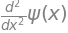

In [277]:
psi(x).diff(x,x)

In [278]:
-k**2*psi(x)


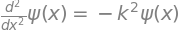

In [279]:
eq = sp.Eq(psi(x).diff(x,x), -k**2 * psi(x))
eq

In [280]:
sol = sp.dsolve(eq, psi(x), ics={psi(0):0}) #ics - initial conditions

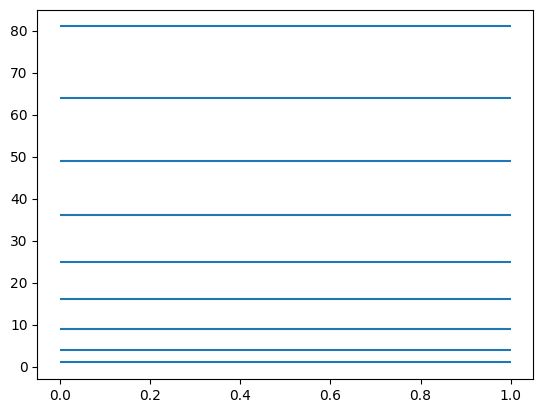

In [281]:
plt.hlines(np.arange(1,10)**2 ,0, 1) #levels of energy

In [282]:
sol = sol.subs(k, n * sp.pi / a)
sol

In [283]:
sol.lhs, sol.rhs #lhs - left hand side

In [284]:
sp.Abs(sol.rhs)**2

In [285]:
sp.integrate((sol.rhs)**2, (x, 0, a))

⎧  2               
⎪C₁ ⋅a      π⋅n    
⎪─────  for ─── ≠ 0
⎨  2         a     
⎪                  
⎪  0     otherwise 
⎩                  

In [286]:
sol = sol.subs(sp.Symbol('C1'), sp.sqrt(2 / a))
sol

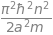

In [287]:
n**2 * sp.pi**2 * h**2 / (2 * m * a**2)

In [288]:
sp.exp(-sp.I * n**2 * sp.pi**2 * h**2 / (2 * m * a**2) * t / h) #solution that depends on time

In [289]:
Psi = sol.rhs * sp.exp(-sp.I * n**2 * sp.pi**2 * h**2 / (2 * m * a**2) * t / h)
Psi

In [290]:
Psif = lambdify((x, t, n), Psi.subs({h:1, m:1, a:1}))

In [291]:
Psif(0.3, 2.3, 1)

(0.3971182633717983+1.0729930471683005j)

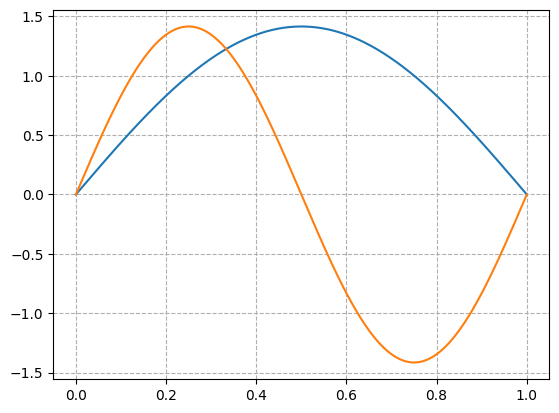

In [292]:
xs = np.linspace(0, 1, 1000)

plt.grid(linestyle= '--')

ys = Psif (xs, 0 ,1).real
plt.plot(xs, ys)

ys = Psif (xs, 0 ,2).real
plt.plot(xs, ys)


In [293]:
n = 1

xs = np.linspace(0, 1, 1000)

fig = plt.figure()

plt.xlim(0,1)
plt.ylim(-1.5, 1.5)

plot1, = plt.plot([],[])
plot2, = plt.plot([],[])

plt.close()

dt= 0.001

def frame(i):
    t = i * dt

    ys = Psif(xs, t, n)
    ys1 = ys.real
    ys2 = ys.imag

    plot1.set_data(xs, ys1)
    plot2.set_data(xs, ys2)

    return plot1, plot2

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())

In [294]:
n = 1

xs = np.linspace(0, 1, 1000)

fig = plt.figure()

plt.grid(linestyle= "--")

plot1, = plt.plot([],[])

plt.xlim(0,1)
plt.ylim(0, 2)

plt.close()

dt= 0.001

def frame(i):
    t = i * dt

    ys = Psif(xs, t, n)

    plot1.set_data(xs, np.abs(ys)**2)


    return plot1,

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())

In [295]:
xs = np.linspace(0, 1, 1000)

fig = plt.figure()

plt.grid(linestyle= "--")

plot1, = plt.plot([],[])

plt.xlim(0,1)
plt.ylim(0,4)

plt.close()

dt= 0.001

def frame(i):
    t = i * dt

    ys = (Psif(xs, t, 1) + Psif(xs, t, 2)) / np.sqrt(2)

    plot1.set_data(xs, np.abs(ys)**2)


    return plot1,

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())

In [300]:
sol.rhs * x * sol.rhs

In [303]:
sp.integrate(sol.rhs * x * sol.rhs, (x, 0, a)).simplify()

⎧a                   
⎪─  for n > 0 ∨ n < 0
⎨2                   
⎪                    
⎩0      otherwise    

In [304]:
sp.integrate(sol.rhs * x**2 * sol.rhs, (x, 0, a)).simplify()

⎧ 2       2                     
⎪a       a                      
⎪── - ───────  for n > 0 ∨ n < 0
⎨3       2  2                   
⎪     2⋅π ⋅n                    
⎪                               
⎩     0            otherwise    

In [ ]:
#Todo:
#średni pęd, średni kwadrat pędu
#(wiedząc że średni pęd ma być równy 0)

##<p>=?##
##<p^2>=?##

In [311]:
sol.rhs

In [313]:
sol.rhs.diff(x)*((-sp.I)*h) * sol.rhs

In [315]:
#średni pęd, <p>=?
sp.integrate(sol.rhs.diff(x)*((-sp.I)*h) * sol.rhs, (x, 0, a))

In [317]:
#średni kwadrat pędu, <p^2>=?
sp.integrate(sol.rhs.diff(x,x)*((-sp.I)*h) * sol.rhs, (x, 0, a))

⎛⎧     0       for a ≠ 0⎞            
⎜⎪                      ⎟      2    2
⎜⎪    2    2            ⎟   ⅈ⋅π ⋅h̅⋅n 
⎜⎨-ⅈ⋅π ⋅h̅⋅n             ⎟ + ─────────
⎜⎪───────────  otherwise⎟        2   
⎜⎪      2               ⎟       a    
⎝⎩     a                ⎠            